# LDDMM: parallel transporting face motion

This notebook shows how to run [Deformetrica's parallel transport example](
https://gitlab.com/icm-institute/aramislab/deformetrica/-/wikis/2_tutorials/2.5_parallel_transport) (surface mesh section).

In [1]:
import os
from pathlib import Path

import numpy as np
import pyvista as pv
from in_out.array_readers_and_writers import read_3D_array

import polpo.lddmm as plddmm
import polpo.preprocessing.dict as ppdict
from polpo.plot.pyvista import RegisteredMeshesGifPlotter
from polpo.preprocessing import IndexSelector, Map
from polpo.preprocessing.load.deformetrica import (
    LoadControlPointsFlow,
    LoadMeshFlow,
    LoadMomentaFlow,
)
from polpo.preprocessing.mesh.io import PvReader
from polpo.preprocessing.path import FileFinder
from polpo.preprocessing.str import Contains, DigitFinder, RegexGroupFinder

W0929 12:20:36.275000 178958 site-packages/torch/utils/cpp_extension.py:118] No CUDA runtime is found, using CUDA_HOME='/usr'


In [2]:
DEBUG = False
STATIC_VIZ = True

if STATIC_VIZ:
    pv.set_jupyter_backend("static")


viz_transform = pv.Transform()
viz_transform.rotate_y(45)
viz_transform.rotate_z(45)

viz_transform_alien = pv.Transform()
viz_transform_alien.rotate_y(75)
viz_transform_alien.rotate_z(45)

path_to_tp = RegexGroupFinder(r"_tp_(\d+)") + int


truncate_dict = ppdict.TruncateDict(n_keys=10)

In [3]:
DATA_DIR = Path("_data/alien/data")

OUTPUTS_DIR = Path("results/alien")

OUTPUTS_DIR_CLI = Path("results/alien/output")
OUTPUTS_DIR_PY = Path("results/alien/output_py")

FULL_RUN_DIR = OUTPUTS_DIR_PY / "full"
SHOOT_DIR = OUTPUTS_DIR_PY / "shoot"
PARALLEL_DIR = OUTPUTS_DIR_PY / "parallel"
POLE_LADDER_DIR = OUTPUTS_DIR_PY / "pole"

In [4]:
def compute_max_vertex_abs_diff(mesh_dict, cmp_mesh_dict):
    keys = set(mesh_dict.keys()).intersection(set(cmp_mesh_dict.keys()))

    diffs = [
        np.amax(np.abs(mesh_dict[key].points - cmp_mesh_dict[key].points))
        for key in keys
    ]

    return np.amax(diffs)

In [5]:
kernel_width = 0.005

## Initial data

Let's visualize the input data, i.e. the base shape and the geodesic (parametrized by control points and momenta).

In [6]:
cp_name = DATA_DIR / "control_points.txt"
momenta_name = DATA_DIR / "momenta.txt"
momenta_to_transport_name = DATA_DIR / "momenta_to_transport.txt"

base_shape_name = DATA_DIR / "face.vtk"

In [7]:
base_shape = PvReader()(base_shape_name)

cp, momenta = read_3D_array(cp_name), read_3D_array(momenta_name)

In [8]:
base_shape.n_points, cp.shape, momenta.shape

(240, (240, 3), (240, 3))

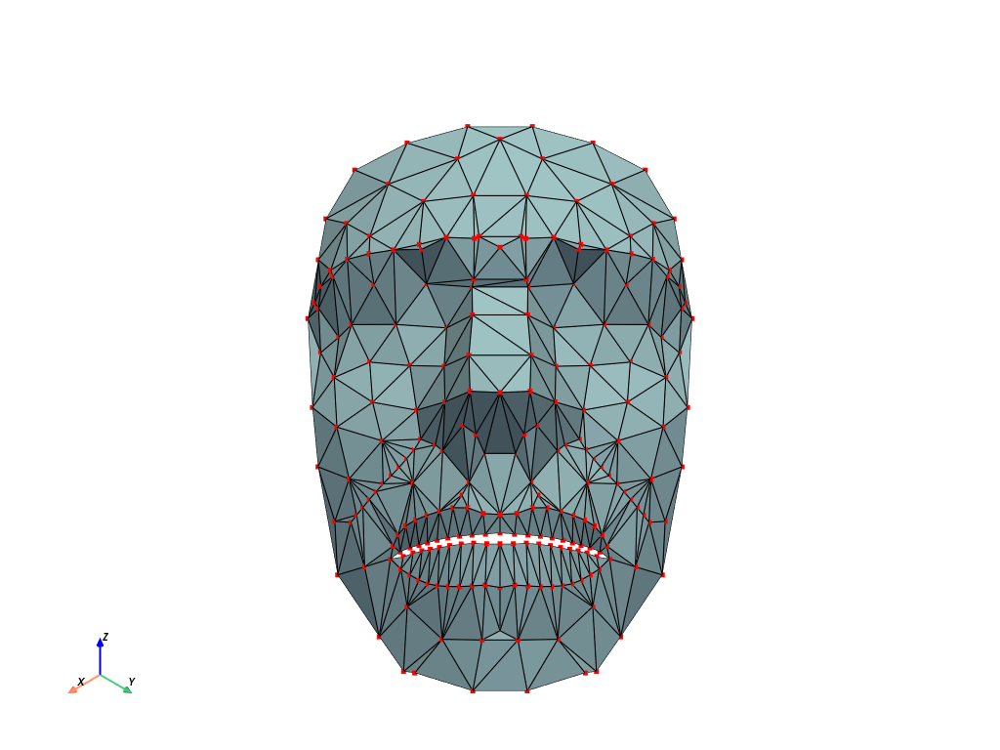

In [9]:
pl = pv.Plotter(border=False)

base_shape.clear_data()

pl.add_mesh(base_shape.transform(viz_transform, inplace=False), show_edges=True)
pl.add_points(pv.PolyData(cp).transform(viz_transform, inplace=False), color="red")

pl.add_axes()

pl.show()

Now, we run the CLI (check `model.xml` for run details; spoiler: it runs parallel transport).

In [10]:
if not DEBUG or not OUTPUTS_DIR_CLI.exists():
    os.system(f"deformetrica compute _data/alien/model.xml -o {OUTPUTS_DIR_CLI}")

W0929 12:20:40.868000 179265 site-packages/torch/utils/cpp_extension.py:118] No CUDA runtime is found, using CUDA_HOME='/usr'


Logger has been set to: WARNING


Traceback (most recent call last):
  File "/home/luisfpereira/miniconda3/envs/deformetrica/bin/deformetrica", line 7, in <module>
    sys.exit(main())
             ^^^^^^
  File "/home/luisfpereira/miniconda3/envs/deformetrica/lib/python3.12/site-packages/deformetrica.py", line 207, in main
    deformetrica.compute_parallel_transport(
  File "/home/luisfpereira/miniconda3/envs/deformetrica/lib/python3.12/site-packages/api/deformetrica.py", line 517, in compute_parallel_transport
    compute_parallel_transport(template_specifications, output_dir=self.output_dir, **model_options)
TypeError: compute_parallel_transport() got an unexpected keyword argument 'deformation_kernel_device'


The above is equivalent to running the following code.

In [11]:
if not DEBUG or not FULL_RUN_DIR.exists():
    plddmm.geometry.parallel_transport(
        source=base_shape_name,
        control_points=cp_name,
        momenta=momenta_name,
        momenta_to_transport=momenta_to_transport_name,
        kernel_width=kernel_width,
        concentration_of_time_points=10,
        output_dir=FULL_RUN_DIR,
        tmin=0,
        tmax=9,
    )

initial-control-points-to-transport was not specified, I am assuming they are the same as initial-control-points
/home/luisfpereira/miniconda3/envs/deformetrica/lib/python3.12/site-packages/in_out/dataset_functions.py:265: UserWarning: Watch out, I did not get a distance type for the object shape, Please make sure you are running shooting or a parallel transport, otherwise distances are required.
  warnings.warn(msg)


A quick sanity check of the equivalence of both runs.

In [12]:
parallel_meshes_pipe = LoadMeshFlow(
    as_path=False,
    extra_rules=Contains("parallel_curve"),
)

parallel_meshes = parallel_meshes_pipe(OUTPUTS_DIR_CLI)
parallel_meshes_ = parallel_meshes_pipe(FULL_RUN_DIR)

In [13]:
compute_max_vertex_abs_diff(parallel_meshes, parallel_meshes_)

np.float64(0.0)

## Geodesic flow

Points along the geodesic are computed when calling parallel transport.


Available output files:

* meshes: `Regression_GeodesicFlow_face_tp_*_age_*.vtk`

* control points: `ControlPoints_tp_*__age_*.txt`

* momenta: `Momenta_tp_*__age_*.txt`


In [14]:
mesh_flow_pipe = LoadMeshFlow(
    as_path=False,
    extra_rules=Contains("_GeodesicFlow_"),
)

In [15]:
regression_meshes = mesh_flow_pipe(OUTPUTS_DIR_CLI)

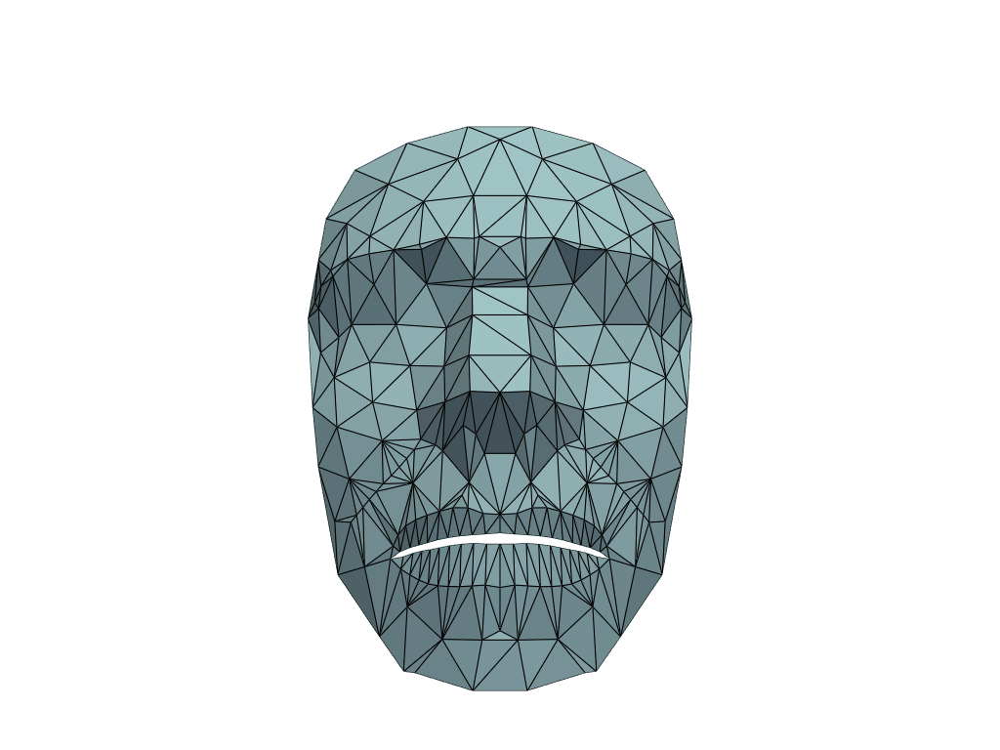

In [16]:
meshes = {
    key: mesh.transform(viz_transform, inplace=False)
    for key, mesh in regression_meshes.items()
}

if DEBUG:
    meshes = truncate_dict(meshes)


pl = RegisteredMeshesGifPlotter(
    fps=10,
    border=False,
    off_screen=True,
    notebook=False,
)

pl.add_meshes(meshes)
pl.close()

pl.show()

The above, can be achieved with shooting.

Available output files (assuming `write_params=True`):

* meshes: `Shooting__GeodesicFlow__shape__tp_*__age_*.vtk`

* control points: `Shooting__GeodesicFlow__ControlPoints__tp_*__age_*.txt`

* momenta: `Shooting__GeodesicFlow__Momenta__tp_*__age_*.txt`



In [17]:
# TODO: make dict with kernel specification?
plddmm.geometry.shoot(
    source=base_shape_name,
    control_points=cp_name,
    momenta=momenta_name,
    kernel_width=kernel_width,
    concentration_of_time_points=10,
    kernel_type="torch",
    output_dir=SHOOT_DIR,
    write_adjoint_parameters=True,
    tmin=0.0,
    tmax=9.0,
)

Defaulting geodesic t0 to 1.


In [18]:
regression_meshes_ = mesh_flow_pipe(SHOOT_DIR)

In [19]:
compute_max_vertex_abs_diff(regression_meshes, regression_meshes_)

np.float64(9.763240814208984e-05)

Control points and momenta are also available.

In [20]:
cp_flow_pipe = LoadControlPointsFlow(as_path=False)

In [21]:
cps = cp_flow_pipe(OUTPUTS_DIR_CLI)
cps_ = cp_flow_pipe(SHOOT_DIR)

np.amax(np.abs(cps - cps_))

np.float64(3.6000000000036e-05)

In [22]:
momenta_flow_pipe = LoadMomentaFlow(
    as_path=False,
    extra_rules=Contains("Transported", negate=True),
)

In [23]:
momenta = momenta_flow_pipe(OUTPUTS_DIR_CLI)
momenta_ = momenta_flow_pipe(SHOOT_DIR)

np.amax(np.abs(momenta - momenta_))

np.float64(1.4572500000000193e-05)

## Parallel curve

Meshes along the parallel geodesic can be found under the name `face_parallel_curve_tp_*__age_*.vtk`.

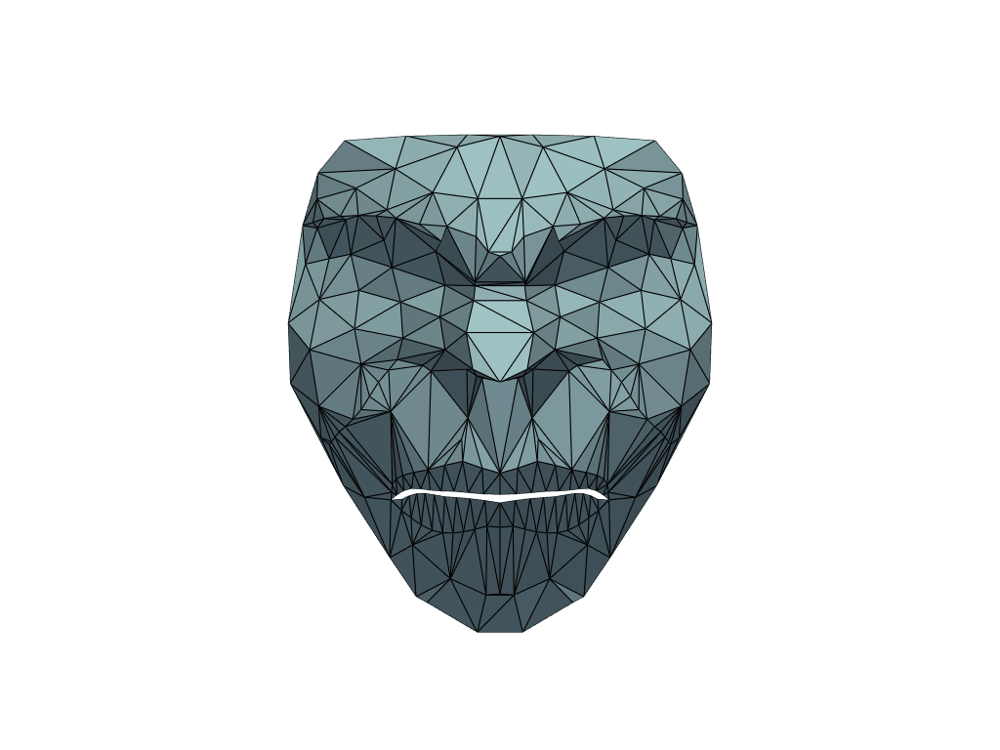

In [24]:
meshes = {
    key: mesh.transform(viz_transform_alien, inplace=False)
    for key, mesh in parallel_meshes.items()
}

if DEBUG:
    meshes = truncate_dict(meshes)


pl = RegisteredMeshesGifPlotter(
    fps=10,
    border=False,
    off_screen=True,
    notebook=False,
)

pl.add_meshes(meshes)
pl.close()

pl.show()

The parallel geodesic is obtained by shooting from the main geodesic using the transported momenta.

In [25]:
mesh_flow_names_pipe = LoadMeshFlow(
    as_path=True,
    extra_rules=Contains("_GeodesicFlow_"),
)
regression_meshes_names = mesh_flow_names_pipe(OUTPUTS_DIR_CLI)

cp_flow_names_pipe = LoadControlPointsFlow(as_path=True)
cp_names = cp_flow_names_pipe(OUTPUTS_DIR_CLI)

trans_momenta_name_flow_pipe = LoadMomentaFlow(
    as_path=True,
    extra_rules=Contains("Transported"),
)
transported_momenta_names = trans_momenta_name_flow_pipe(OUTPUTS_DIR_CLI)

In [26]:
data = ppdict.DictMerger(as_dict=True)(
    (
        regression_meshes_names,
        cp_names,
        transported_momenta_names,
    )
)

# if fails for 16, 27
data = ppdict.TruncateDict(n_keys=16)(data)

if DEBUG:
    data = truncate_dict(data)


for key, (mesh_name, cps_name, momenta_name) in data.items():
    plddmm.geometry.shoot(
        source=mesh_name,
        control_points=cps_name,
        momenta=momenta_name,
        kernel_width=kernel_width,
        number_of_time_steps=10,
        kernel_type="torch",
        output_dir=PARALLEL_DIR / f"tp_{key}",
        write_adjoint_parameters=False,
    )

Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.
Defaulting geodesic t0 to 1.
Defaulting geodesic tmax to 1.
Defaulting geodesic tmin to 0.

In [27]:
file_finder = (
    FileFinder(rules=Contains("tp_"))
    + ppdict.HashWithIncoming(key_step=Map(DigitFinder()), key_sorter=lambda x: x)
    + ppdict.DictMap(
        mesh_flow_names_pipe + (lambda x: x.popitem()) + IndexSelector(index=1)
    )
)

pipe = file_finder + ppdict.DictMap(plddmm.io._file2mesh(as_pv=True))

parallel_meshes_ = pipe(PARALLEL_DIR)

In [28]:
compute_max_vertex_abs_diff(parallel_meshes, parallel_meshes_)

np.float64(33.456961154937744)

Oops, there's some differences in the results. See below for an attempt to understand issue.

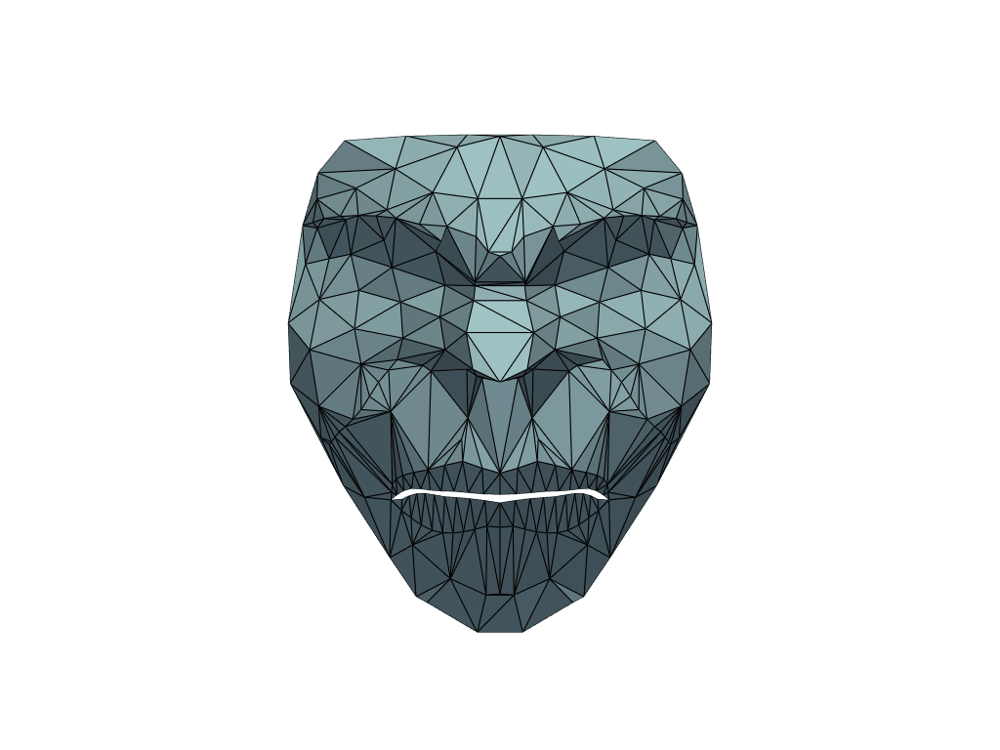

In [29]:
meshes = {
    key: mesh.transform(viz_transform_alien, inplace=False)
    for key, mesh in parallel_meshes_.items()
}


pl = RegisteredMeshesGifPlotter(
    fps=10,
    border=False,
    off_screen=True,
    notebook=False,
)

pl.add_meshes(meshes)
pl.close()

pl.show()

## Pole ladder

In [30]:
if not DEBUG or not OUTPUTS_DIR_CLI.exists():
    plddmm.geometry.pole_ladder(
        cp_name,
        momenta_name,
        momenta_to_transport_name,
        output_dir=POLE_LADDER_DIR,
        kernel_width=kernel_width,
        tmin=0.0,
        tmax=9.0,
    )

transported_cp_ = plddmm.io.load_cp(POLE_LADDER_DIR, as_path=False)
transported_mom_ = plddmm.io.load_momenta(POLE_LADDER_DIR, as_path=False)

initial-control-points-to-transport was not specified, I am assuming they are the same as initial-control-points
In exponential update, I am not flowing because I don't have any template points to flow
In exponential update, I am not flowing because I don't have any template points to flow


In [31]:
transported_mom = LoadMomentaFlow(
    as_path=False,
    as_array=True,
    extra_rules=Contains("Transported"),
)(OUTPUTS_DIR_CLI)[-1]

In [32]:
np.amax(np.abs(transported_mom - transported_mom_))

np.float64(1.16162692)